# Generating Anime NPC Faces using a GAN for Video Games
## The project uses techniques of a generator and discriminator model within a Generative Adversarial Network. The choice for this machine learning technique is due to the effective learning of anime faces and the generation of random, non-player character attributive designs. These designs should be low effort and be based on generic faces as opposed to the main characters of a video game which require more effort in design. Learning a generic face set based on the expected game environment and generic face dataset allows for a low effort, random face generator for NPCs that are scattered throughout the video game world.


### First, import some libraries utilized within the code.
### PyTorch is used as the backbone for the approach. For a variety of results on each run, I used a random seed generating numbers between 1 and 100000. The results are then displayed in an html animation to show the different generated faces for each epoch as well as the improvement in the faces as epochs are executed.

In [1]:
%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML


seed = random.randint(1, 100000)

random.seed(seed)
torch.manual_seed(seed)

### Variable definitions for use throughout the network. I chose a z batch size of 100 and a learning rate of 0.0002 as commonly shown from previous research and in class. 

In [2]:
# Root directory for dataset
dataroot = "/kaggle/input/"

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 128

# Spatial size of training images
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
zBatch = 100

# Size of feature maps in generator
featureMapGenSize = 64

# Size of feature maps in discriminator
featureMapDiscrimSize = 64

# Number of epochs
num_epochs = 75 

# Learning rate 
learningRate = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

ngpu = 1

## Create and preview the dataset

cuda:0


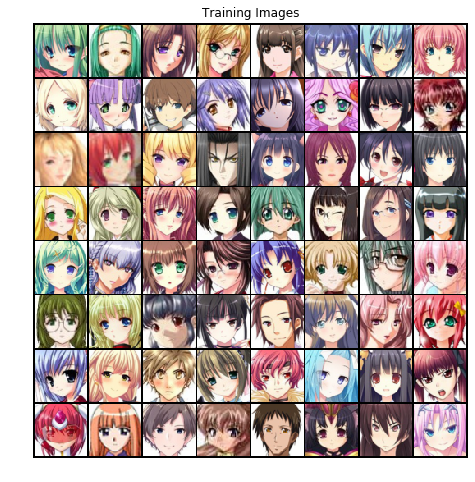

In [3]:
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")
print (device)

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8, 8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [4]:
print (torch.cuda.get_device_name(0))

Tesla P100-PCIE-16GB


# DCGAN Implementation

### Initialize weights

In [5]:
# Custom weights initialization called on generator and discriminator
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

## Generator

In [6]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # use convolution with the zBatch as an input, then normalize and use ReLU
            nn.ConvTranspose2d(zBatch, featureMapGenSize * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(featureMapGenSize * 8),
            nn.ReLU(True),
            
            # state size. (featureMapGenSize*8) x 4 x 4
            nn.ConvTranspose2d(featureMapGenSize * 8, featureMapGenSize * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(featureMapGenSize * 4),
            nn.ReLU(True),
            
            # state size. (featureMapGenSize*4) x 8 x 8
            nn.ConvTranspose2d( featureMapGenSize * 4, featureMapGenSize * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(featureMapGenSize * 2),
            nn.ReLU(True),
            
            # state size. (featureMapGenSize*2) x 16 x 16
            nn.ConvTranspose2d( featureMapGenSize * 2, featureMapGenSize, 4, 2, 1, bias=False),
            nn.BatchNorm2d(featureMapGenSize),
            nn.ReLU(True),
            
            # state size. (featureMapGenSize) x 32 x 32
            nn.ConvTranspose2d( featureMapGenSize, nc, 4, 2, 1, bias=False),
            nn.Tanh()
        )

    def forward(self, input):
        return self.main(input)

In [7]:
# Create the generator
generator = Generator(ngpu).to(device)

if (device.type == 'cuda') and (ngpu > 1):
    generator = nn.DataParallel(netG, list(range(ngpu)))

# randomly initialize the weights
generator.apply(weights_init)

print(generator)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


## Discriminator

In [8]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, featureMapDiscrimSize, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            
            # state size. (featureMapDiscrimSize) x 32 x 32
            nn.Conv2d(featureMapDiscrimSize, featureMapDiscrimSize * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(featureMapDiscrimSize * 2),
            nn.LeakyReLU(0.2, inplace=True),
            
            # state size. (featureMapDiscrimSize*2) x 16 x 16
            nn.Conv2d(featureMapDiscrimSize * 2, featureMapDiscrimSize * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(featureMapDiscrimSize * 4),
            nn.LeakyReLU(0.2, inplace=True),
            
            # state size. (featureMapDiscrimSize*4) x 8 x 8
            nn.Conv2d(featureMapDiscrimSize * 4, featureMapDiscrimSize * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(featureMapDiscrimSize * 8),
            nn.LeakyReLU(0.2, inplace=True),
            
            # state size. (featureMapDiscrimSize*8) x 4 x 4
            nn.Conv2d(featureMapDiscrimSize * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [9]:
# Create the Discriminator
discriminator = Discriminator(ngpu).to(device)

if (device.type == 'cuda') and (ngpu > 1):
    discriminator = nn.DataParallel(netD, list(range(ngpu)))

# randomly initialize the weights
discriminator.apply(weights_init)

print(discriminator)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


# Training

### Loss functions and Optimizers

In [10]:
# Loss Function
criterion = nn.BCELoss()

# Random noise for generator
noise = torch.randn(64, zBatch, 1, 1, device=device)

# Establish convention for real and fake labels during training
realLabel = 1
fakeLabel = 0

# Setup Adam optimizers 
optimizerGenerator = optim.Adam(generator.parameters(), lr=learningRate, betas=(beta1, 0.999))
optimizerDiscriminator = optim.Adam(discriminator.parameters(), lr=learningRate, betas=(beta1, 0.999))

### Begin training

In [11]:
img_list = []
generatorLosses = []
discriminatorLosses = []
iters = 0

print("Training...")

for epoch in range(num_epochs):
    for i, data in enumerate(dataloader, 0):

        # zero the grads
        discriminator.zero_grad()
        
        # Updating the Discriminator
        real_cpu = data[0].to(device)
      
        batchSize = real_cpu.size(0)
        label = torch.full((batchSize, ), realLabel, device=device)
        
        # Forward propogation for discriminator
        output = discriminator(real_cpu).view(-1)
        
        # calculate real image losses for discriminator
        realDiscriminatorLosses = criterion(output, label)
        
        # Backward propogation for discriminator
        realDiscriminatorLosses.backward()
        D_x = output.mean().item()

        # Training
        # create random noise for generator
        noise = torch.randn(batchSize, zBatch, 1, 1, device=device)
        
        
        fakeImage = generator(noise)
        label.fill_(fakeLabel)
        
        # Classification of batches with discriminator
        output = discriminator(fakeImage.detach()).view(-1)
        
        # Calculate fake image losses for discriminator
        fakeDiscriminatorLoss = criterion(output, label)
        
        # Backwards propogation on the fake batches
        fakeDiscriminatorLoss.backward()
        D_G_z1 = output.mean().item()
        
        totalLossesDiscriminator = realDiscriminatorLosses + fakeDiscriminatorLoss
        
        # Update the discriminator
        optimizerDiscriminator.step()
        
        # Updating the Generator
        
        # zero the grads
        generator.zero_grad()
        
        label.fill_(realLabel)
        output = discriminator(fakeImage).view(-1)
       
        # Calculate generator loss
        generatorLoss = criterion(output, label)
        
        # Backwards propogation for the losses on the generator
        generatorLoss.backward()
        
        D_G_z2 = output.mean().item()
       
        # Update the generator
        optimizerGenerator.step()

        if i % 1000 == 0:
            print('[%d/%d][%d/%d]\Discriminator Loss: %.4f\tGenerator Loss: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     totalLossesDiscriminator.item(), generatorLoss.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        generatorLosses.append(generatorLoss.item())
        discriminatorLosses.append(totalLossesDiscriminator.item())

        if (iters % 250 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fakeImage = generator(noise).detach().cpu()
            img_list.append(vutils.make_grid(fakeImage, padding=2, normalize=True))

        iters += 1

Training...
[0/75][0/497]\Discriminator Loss: 1.3921	Generator Loss: 4.1693	D(x): 0.5187	D(G(z)): 0.4145 / 0.0233
[1/75][0/497]\Discriminator Loss: 1.1795	Generator Loss: 9.7233	D(x): 0.8831	D(G(z)): 0.5781 / 0.0002
[2/75][0/497]\Discriminator Loss: 0.5266	Generator Loss: 5.7125	D(x): 0.8162	D(G(z)): 0.2104 / 0.0050
[3/75][0/497]\Discriminator Loss: 0.1729	Generator Loss: 3.9028	D(x): 0.8840	D(G(z)): 0.0244 / 0.0439
[4/75][0/497]\Discriminator Loss: 0.2405	Generator Loss: 5.0732	D(x): 0.8846	D(G(z)): 0.0739 / 0.0097
[5/75][0/497]\Discriminator Loss: 0.4533	Generator Loss: 8.6554	D(x): 0.9972	D(G(z)): 0.3217 / 0.0005
[6/75][0/497]\Discriminator Loss: 0.1846	Generator Loss: 4.5464	D(x): 0.9406	D(G(z)): 0.0995 / 0.0203
[7/75][0/497]\Discriminator Loss: 0.4072	Generator Loss: 6.3487	D(x): 0.9318	D(G(z)): 0.2424 / 0.0033
[8/75][0/497]\Discriminator Loss: 0.2191	Generator Loss: 5.2519	D(x): 0.8916	D(G(z)): 0.0747 / 0.0115
[9/75][0/497]\Discriminator Loss: 0.3242	Generator Loss: 3.5310	D(x): 

# Results

### Loss plot

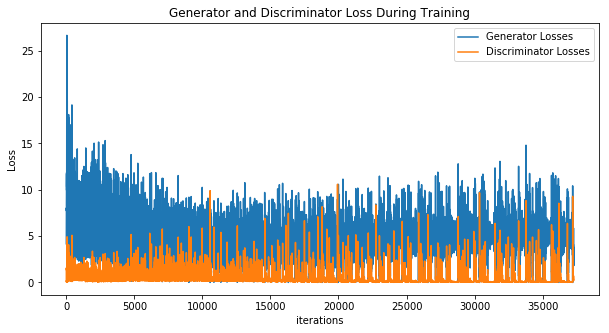

In [12]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(generatorLosses,label="Generator Losses")
plt.plot(discriminatorLosses,label="Discriminator Losses")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

### Training process

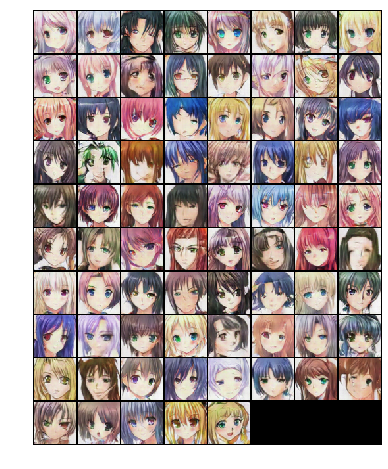

In [13]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

# Final Results

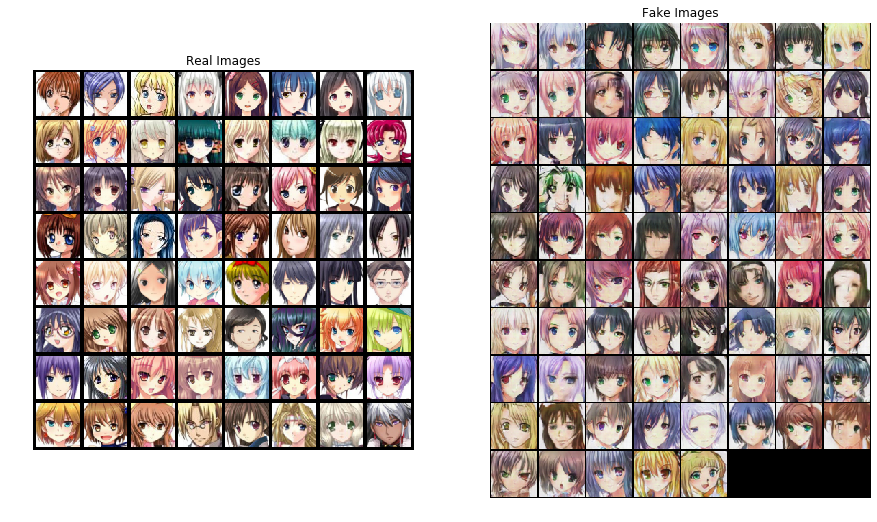

In [14]:
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()